# Name Plate detection Model using Inception ResNet Model and YOLO

# Inception ResNet Model

In [ ]:
!pip install pytesseract

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
import pytesseract as pt
import plotly.express as px
import matplotlib.pyplot as plt
import xml.etree.ElementTree as xet

from glob import glob
from skimage import io
from shutil import copy
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten, Input
from tensorflow.keras.preprocessing.image import load_img, img_to_array


In [ ]:
# prompt: https://www.kaggle.com/datasets/aslanahmedov/number-plate-detection
# load the dataset from this kaggle . i can't see it in the /content directory

!kaggle datasets download -d aslanahmedov/number-plate-detection -p /content/number_plate_detection
!unzip -q /content/number_plate_detection/number-plate-detection.zip -d /content/number_plate_detection


Dataset URL: https://www.kaggle.com/datasets/aslanahmedov/number-plate-detection
License(s): copyright-authors
number-plate-detection.zip: Skipping, found more recently modified local copy (use --force to force download)
replace /content/number_plate_detection/TEST/TEST.jpeg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
path = glob('/content/number_plate_detection/images/*.xml')
labels_dict = dict(filepath=[],xmin=[],xmax=[],ymin=[],ymax=[])
for filename in path:

    info = xet.parse(filename)
    root = info.getroot()
    member_object = root.find('object')
    labels_info = member_object.find('bndbox')
    xmin = int(labels_info.find('xmin').text)
    xmax = int(labels_info.find('xmax').text)
    ymin = int(labels_info.find('ymin').text)
    ymax = int(labels_info.find('ymax').text)

    labels_dict['filepath'].append(filename)
    labels_dict['xmin'].append(xmin)
    labels_dict['xmax'].append(xmax)
    labels_dict['ymin'].append(ymin)
    labels_dict['ymax'].append(ymax)

In [ ]:
df = pd.DataFrame(labels_dict)
df.to_csv('labels.csv',index=False)
df.head()

,filepath,xmin,xmax,ymin,ymax
0,/content/number_plate_detection/images/N67.xml,164,336,162,195
1,/content/number_plate_detection/images/N152.xml,265,725,247,347
2,/content/number_plate_detection/images/N99.xml,158,389,129,193
3,/content/number_plate_detection/images/N135.xml,157,341,197,247
4,/content/number_plate_detection/images/N118.xml,532,852,636,706


In [ ]:
filename = df['filepath'][0]
filename

'/content/number_plate_detection/images/N67.xml'

In [ ]:
filename = df['filepath'][0]
def getFilename(filename):
    filename_image = xet.parse(filename).getroot().find('filename').text
    filepath_image = os.path.join('/content/number_plate_detection/images',filename_image)
    return filepath_image
getFilename(filename)

'/content/number_plate_detection/images/N67.jpeg'

In [ ]:
image_path = list(df['filepath'].apply(getFilename))
image_path[:10]#random check

['/content/number_plate_detection/images/N67.jpeg',
 '/content/number_plate_detection/images/N152.jpeg',
 '/content/number_plate_detection/images/N99.jpeg',
 '/content/number_plate_detection/images/N135.jpeg',
 '/content/number_plate_detection/images/N118.jpeg',
 '/content/number_plate_detection/images/N130.jpeg',
 '/content/number_plate_detection/images/N212.jpeg',
 '/content/number_plate_detection/images/N98.jpeg',
 '/content/number_plate_detection/images/N40.jpeg',
 '/content/number_plate_detection/images/N61.jpeg']

In [ ]:

file_path = '/content/number_plate_detection/images/N2.jpeg' #path of our image N2.jpeg
img = cv2.imread(file_path) #read the image
# xmin-1804/ymin-1734/xmax-2493/ymax-1882
img = io.imread(file_path) #Read the image
fig = px.imshow(img)
fig.update_layout(width=600, height=500, margin=dict(l=10, r=10, b=10, t=10),xaxis_title='Figure 8 - N2.jpeg with bounding box')
fig.add_shape(type='rect',x0=1804, x1=2493, y0=1734, y1=1882, xref='x', yref='y',line_color='cyan')

In [ ]:
#Targeting all our values in array selecting all columns
labels = df.iloc[:,1:].values
data = []
output = []
for ind in range(len(image_path)):
    image = image_path[ind]
    img_arr = cv2.imread(image)
    h,w,d = img_arr.shape
    # Prepprocesing
    load_image = load_img(image,target_size=(224,224))
    load_image_arr = img_to_array(load_image)
    norm_load_image_arr = load_image_arr/255.0 # Normalization
    # Normalization to labels
    xmin,xmax,ymin,ymax = labels[ind]
    nxmin,nxmax = xmin/w,xmax/w
    nymin,nymax = ymin/h,ymax/h
    label_norm = (nxmin,nxmax,nymin,nymax) # Normalized output
    # Append
    data.append(norm_load_image_arr)
    output.append(label_norm)

In [ ]:
# Convert data to array
X = np.array(data,dtype=np.float32)
y = np.array(output,dtype=np.float32)

In [ ]:
# Split the data into training and testing set using sklearn.
x_train,x_test,y_train,y_test = train_test_split(X,y,train_size=0.8,random_state=0)
x_train.shape,x_test.shape,y_train.shape,y_test.shape

((180, 224, 224, 3), (45, 224, 224, 3), (180, 4), (45, 4))

In [ ]:
inception_resnet = InceptionResNetV2(weights="imagenet",include_top=False, input_tensor=Input(shape=(224,224,3)))
# ---------------------
headmodel = inception_resnet.output
headmodel = Flatten()(headmodel)
headmodel = Dense(500,activation="relu")(headmodel)
headmodel = Dense(250,activation="relu")(headmodel)
headmodel = Dense(4,activation='sigmoid')(headmodel)


# ---------- model
model = Model(inputs=inception_resnet.input,outputs=headmodel)

In [ ]:
# Complie model
model.compile(loss='mse',optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4))
model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_812 (Conv2D)       │ (None, 111, 111, 32)   │            864 │ input_layer_5[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_812   │ (None, 111, 111, 32)   │             96 │ conv2d_812[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_812            │ (None, 111, 111, 32)   │              0 │ batch_normalization_8… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_813 (Conv2D)       │ (None, 109, 109, 32)   │          9,216 │ activation_812[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_813   │ (None, 109, 109, 32)   │             96 │ conv2d_813[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_813            │ (None, 109, 109, 32)   │              0 │ batch_normalization_8… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_814 (Conv2D)       │ (None, 109, 109, 64)   │         18,432 │ activation_813[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_814   │ (None, 109, 109, 64)   │            192 │ conv2d_814[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_814            │ (None, 109, 109, 64)   │              0 │ batch_normalization_8… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_16          │ (None, 54, 54, 64)     │              0 │ activation_814[0][0]   │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_815 (Conv2D)       │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d_16[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_815   │ (None, 54, 54, 80)     │            240 │ conv2d_815[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_815            │ (None, 54, 54, 80)     │              0 │ batch_normalization_8… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_816 (Conv2D)  

 Total params: 73,666,490 (281.02 MB)

 Trainable params: 73,604,446 (280.78 MB)

 Non-trainable params: 62,044 (242.36 KB)

In [ ]:
tfb = TensorBoard('object_detection')
history = model.fit(x=x_train,y=y_train,batch_size=10,epochs=180,
                    validation_data=(x_test,y_test),callbacks=[tfb])

Epoch 1/180


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning:

The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_3145']
Received: inputs=Tensor(shape=(10, 224, 224, 3))



18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 3.2528

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning:

The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_3145']
Received: inputs=Tensor(shape=(None, 224, 224, 3))



18/18 ━━━━━━━━━━━━━━━━━━━━ 156s 1s/step - loss: 3.2466 - val_loss: 4.2909
Epoch 2/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - loss: 3.1610 - val_loss: 7.4570
Epoch 3/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - loss: 2.9567 - val_loss: 7.6806
Epoch 4/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - loss: 2.6086 - val_loss: 5.5257
Epoch 5/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - loss: 2.4538 - val_loss: 3.9821
Epoch 6/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - loss: 2.3423 - val_loss: 2.2785
Epoch 7/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - loss: 1.9054 - val_loss: 1.5855
Epoch 8/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - loss: 1.7943 - val_loss: 1.9735
Epoch 9/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - loss: 1.9194 - val_loss: 2.1703
Epoch 10/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - loss: 1.7887 - val_loss: 1.2670
Epoch 11/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - loss: 1.9942 - val_loss: 0.8925
Epoch 12/180
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step 

In [ ]:
model.save('plate_detection.h5')

In [ ]:
path = '/content/number_plate_detection/images/N4.jpeg'

In [ ]:
# Create pipeline
# path = '../input/number-plate-detection/TEST/TEST.jpeg'
def object_detection(path):

    # Read image
    image = load_img(path) # PIL object
    image = np.array(image,dtype=np.uint8) # 8 bit array (0,255)
    image1 = load_img(path,target_size=(224,224))

    # Data preprocessing
    image_arr_224 = img_to_array(image1)/255.0 # Convert to array & normalized
    h,w,d = image.shape
    test_arr = image_arr_224.reshape(1,224,224,3)

    # Make predictions
    coords = model.predict(test_arr)

    # Denormalize the values
    denorm = np.array([w,w,h,h])
    coords = coords * denorm
    coords = coords.astype(np.int32)

    # Draw bounding on top the image
    xmin, xmax,ymin,ymax = coords[0]
    pt1 =(xmin,ymin)
    pt2 =(xmax,ymax)
    print(pt1, pt2)
    cv2.rectangle(image,pt1,pt2,(0,255,0),3)
    return image, coords

image, cods = object_detection(path)

fig = px.imshow(image)
fig.update_layout(width=700, height=500, margin=dict(l=10, r=10, b=10, t=10),xaxis_title='Figure 14')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
(863, 1465) (1730, 1729)


# Getting the license plate as output

In [ ]:
img = np.array(load_img(path))
xmin ,xmax,ymin,ymax = cods[0]
roi = img[ymin:ymax,xmin:xmax]
fig = px.imshow(roi)
fig.update_layout(width=350, height=250, margin=dict(l=10, r=10, b=10, t=10),xaxis_title='Figure 15 Cropped image')

# YOLOv5 Model Development for Number plate detection

In [ ]:
# parsing
def parsing(path):
    parser = xet.parse(path).getroot()
    name = parser.find('filename').text
    filename = f'/content/number_plate_detection/images/{name}'

    # width and height
    parser_size = parser.find('size')
    width = int(parser_size.find('width').text)
    height = int(parser_size.find('height').text)

    return filename, width, height
df[['filename','width','height']] = df['filepath'].apply(parsing).apply(pd.Series)
df.head()

,filepath,xmin,xmax,ymin,ymax,filename,width,height
0,/content/number_plate_detection/images/N67.xml,164,336,162,195,/content/number_plate_detection/images/N67.jpeg,500,350
1,/content/number_plate_detection/images/N152.xml,265,725,247,347,/content/number_plate_detection/images/N152.jpeg,919,532
2,/content/number_plate_detection/images/N99.xml,158,389,129,193,/content/number_plate_detection/images/N99.jpeg,474,354
3,/content/number_plate_detection/images/N135.xml,157,341,197,247,/content/number_plate_detection/images/N135.jpeg,470,375
4,/content/number_plate_detection/images/N118.xml,532,852,636,706,/content/number_plate_detection/images/N118.jpeg,1280,960


In [ ]:
path = glob('/content/number_plate_detection/images/*.xml')
labels_dict = dict(filepath=[],xmin=[],xmax=[],ymin=[],ymax=[])
for filename in path:

    info = xet.parse(filename)
    root = info.getroot()
    member_object = root.find('object')
    labels_info = member_object.find('bndbox')
    xmin = int(labels_info.find('xmin').text)
    xmax = int(labels_info.find('xmax').text)
    ymin = int(labels_info.find('ymin').text)
    ymax = int(labels_info.find('ymax').text)

    labels_dict['filepath'].append(filename)
    labels_dict['xmin'].append(xmin)
    labels_dict['xmax'].append(xmax)
    labels_dict['ymin'].append(ymin)
    labels_dict['ymax'].append(ymax)

In [ ]:
df = pd.DataFrame(labels_dict)
df.to_csv('labels.csv',index=False)
df.head()

,filepath,xmin,xmax,ymin,ymax
0,/content/number_plate_detection/images/N67.xml,164,336,162,195
1,/content/number_plate_detection/images/N152.xml,265,725,247,347
2,/content/number_plate_detection/images/N99.xml,158,389,129,193
3,/content/number_plate_detection/images/N135.xml,157,341,197,247
4,/content/number_plate_detection/images/N118.xml,532,852,636,706


In [ ]:
# center_x, center_y, width , height
df['center_x'] = (df['xmax'] + df['xmin'])/(2*df['width'])
df['center_y'] = (df['ymax'] + df['ymin'])/(2*df['height'])

df['bb_width'] = (df['xmax'] - df['xmin'])/df['width']
df['bb_height'] = (df['ymax'] - df['ymin'])/df['height']
df.head()

,filepath,xmin,xmax,ymin,ymax,filename,width,height,center_x,center_y,bb_width,bb_height
0,/content/number_plate_detection/images/N67.xml,164,336,162,195,/content/number_plate_detection/images/N67.jpeg,500,350,0.500000,0.510000,0.344000,0.094286
1,/content/number_plate_detection/images/N152.xml,265,725,247,347,/content/number_plate_detection/images/N152.jpeg,919,532,0.538629,0.558271,0.500544,0.187970
2,/content/number_plate_detection/images/N99.xml,158,389,129,193,/content/number_plate_detection/images/N99.jpeg,474,354,0.577004,0.454802,0.487342,0.180791
3,/content/number_plate_detection/images/N135.xml,157,341,197,247,/content/number_plate_detection/images/N135.jpeg,470,375,0.529787,0.592000,0.391489,0.133333
4,/content/number_plate_detection/images/N118.xml,532,852,636,706,/content/number_plate_detection/images/N118.jpeg,1280,960,0.540625,0.698958,0.250000,0.072917


In [ ]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 17270, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 17270 (delta 0), reused 0 (delta 0), pack-reused 17269 (from 2)
Receiving objects: 100% (17270/17270), 16.11 MiB | 17.64 MiB/s, done.
Resolving deltas: 100% (11861/11861), done.


In [ ]:
!pip install -r ./yolov5/requirements.txt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 921.8/921.8 kB 57.9 MB/s eta 0:00:00


In [ ]:
### split the data into train and test
df_train = df.iloc[:200]
df_test = df.iloc[200:]

In [ ]:
train_folder = '/content/yolov5/data_images/train'

values = df_train[['filename','center_x','center_y','bb_width','bb_height']].values
for fname, x,y, w, h in values:
    image_name = os.path.split(fname)[-1]
    txt_name = os.path.splitext(image_name)[0]

    dst_image_path = os.path.join(train_folder,image_name)
    dst_label_file = os.path.join(train_folder,txt_name+'.txt')

    # copy each image into the folder
    copy(fname,dst_image_path)

    # generate .txt which has label info
    label_txt = f'0 {x} {y} {w} {h}'
    with open(dst_label_file,mode='w') as f:
        f.write(label_txt)

        f.close()

test_folder = '/content/yolov5/data_images/test'

values = df_test[['filename','center_x','center_y','bb_width','bb_height']].values
for fname, x,y, w, h in values:
    image_name = os.path.split(fname)[-1]
    txt_name = os.path.splitext(image_name)[0]

    dst_image_path = os.path.join(test_folder,image_name)
    dst_label_file = os.path.join(test_folder,txt_name+'.txt')

    # copy each image into the folder
    copy(fname,dst_image_path)

    # generate .txt which has label info
    label_txt = f'0 {x} {y} {w} {h}'
    with open(dst_label_file,mode='w') as f:
        f.write(label_txt)

        f.close()

# YOLOv5 Model Training

In [ ]:
!pip install GPUtil

import torch
from GPUtil import showUtilization as gpu_usage
from numba import cuda

def free_gpu_cache():
    print("Initial GPU Usage")
    gpu_usage()

    torch.cuda.empty_cache()

    cuda.select_device(0)
    cuda.close()
    cuda.select_device(0)

    print("GPU Usage after emptying the cache")
    gpu_usage()

free_gpu_cache()

  Preparing metadata (setup.py) ... done
  Created wheel for GPUtil: filename=GPUtil-1.4.0-py3-none-any.whl size=7392 sha256=c45c51d8083b7013d6dbf6c6fe7ba068d59c1b21988c0e51e729cc6c636f7596
  Stored in directory: /root/.cache/pip/wheels/2b/4d/8f/55fb4f7b9b591891e8d3f72977c4ec6c7763b39c19f0861595
Successfully built GPUtil
Initial GPU Usage
| ID | GPU | MEM |
------------------
|  0 |  0% | 57% |
GPU Usage after emptying the cache
| ID | GPU | MEM |
------------------
|  0 | 70% |  1% |


In [ ]:
!python ./yolov5/train.py --data /content/number_plate_detection/data.yaml --cfg ./yolov5/models/yolov5s.yaml --batch-size 8 --name Model --epochs 100

Streaming output truncated to the last 5000 lines.
       9/99      2.06G    0.04803    0.01537          0         10        640:  24% 6/25 [00:00<00:01, 11.92it/s]/content/./yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
       9/99      2.06G    0.04745    0.01512          0         13        640:  32% 8/25 [00:00<00:01, 12.66it/s]/content/./yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
       9/99      2.06G    0.04762    0.01544          0         19        640:  32% 8/25 [00:00<00:01, 12.66it/s]/content/./yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
       9/99      2.06G    0.04747 

# Saving YOLOv5 model

In [ ]:
!python ./yolov5/export.py --weight ./yolov5/runs/train/Model/weights/best.pt --include torchscript onnx

export: data=yolov5/data/coco128.yaml, weights=['./yolov5/runs/train/Model/weights/best.pt'], imgsz=[640, 640], batch_size=1, device=cpu, half=False, inplace=False, keras=False, optimize=False, int8=False, per_tensor=False, dynamic=False, cache=, simplify=False, mlmodel=False, opset=17, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['torchscript', 'onnx']
YOLOv5 🚀 v7.0-398-g5cdad892 Python-3.11.11 torch-2.5.1+cu124 CPU

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs

PyTorch: starting from yolov5/runs/train/Model/weights/best.pt with output shape (1, 25200, 6) (13.8 MB)

TorchScript: starting export with torch 2.5.1+cu124...
TorchScript: export success ✅ 1.4s, saved as yolov5/runs/train/Model/weights/best.torchscript (27.2 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# settings
INPUT_WIDTH =  640
INPUT_HEIGHT = 640

In [ ]:
# LOAD THE IMAGE
img = io.imread('/content/number_plate_detection/TEST/TEST.jpeg')

fig = px.imshow(img)
fig.update_layout(width=700, height=400, margin=dict(l=10, r=10, b=10, t=10))
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
fig.show()

In [ ]:
# LOAD YOLO MODEL
net = cv2.dnn.readNetFromONNX('./yolov5/runs/train/Model/weights/best.onnx')
net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

In [ ]:
def get_detections(img,net):
    # 1.CONVERT IMAGE TO YOLO FORMAT
    image = img.copy()
    row, col, d = image.shape

    max_rc = max(row,col)
    input_image = np.zeros((max_rc,max_rc,3),dtype=np.uint8)
    input_image[0:row,0:col] = image

    # 2. GET PREDICTION FROM YOLO MODEL
    blob = cv2.dnn.blobFromImage(input_image,1/255,(INPUT_WIDTH,INPUT_HEIGHT),swapRB=True,crop=False)
    net.setInput(blob)
    preds = net.forward()
    detections = preds[0]

    return input_image, detections

def non_maximum_supression(input_image,detections):

    # 3. FILTER DETECTIONS BASED ON CONFIDENCE AND PROBABILIY SCORE

    # center x, center y, w , h, conf, proba
    boxes = []
    confidences = []

    image_w, image_h = input_image.shape[:2]
    x_factor = image_w/INPUT_WIDTH
    y_factor = image_h/INPUT_HEIGHT

    for i in range(len(detections)):
        row = detections[i]
        confidence = row[4] # confidence of detecting license plate
        if confidence > 0.4:
            class_score = row[5] # probability score of license plate
            if class_score > 0.25:
                cx, cy , w, h = row[0:4]

                left = int((cx - 0.5*w)*x_factor)
                top = int((cy-0.5*h)*y_factor)
                width = int(w*x_factor)
                height = int(h*y_factor)
                box = np.array([left,top,width,height])

                confidences.append(confidence)
                boxes.append(box)

    # 4.1 CLEAN
    boxes_np = np.array(boxes).tolist()
    confidences_np = np.array(confidences).tolist()

    # 4.2 NMS
    index = cv2.dnn.NMSBoxes(boxes_np,confidences_np,0.25,0.45)

    return boxes_np, confidences_np, index

def drawings(image,boxes_np,confidences_np,index):
    # 5. Drawings
    for ind in index:
        x,y,w,h =  boxes_np[ind]
        bb_conf = confidences_np[ind]
        conf_text = 'plate: {:.0f}%'.format(bb_conf*100)
        # license_text = extract_text(image,boxes_np[ind])


        cv2.rectangle(image,(x,y),(x+w,y+h),(255,0,255),2)
        cv2.rectangle(image,(x,y-30),(x+w,y),(255,0,255),-1)
        cv2.rectangle(image,(x,y+h),(x+w,y+h+25),(0,0,0),-1)


        # cv2.putText(image,conf_text,(x,y-10),cv2.FONT_HERSHEY_SIMPLEX,0.7,(255,255,255),1)
        # cv2.putText(image,license_text,(x,y+h+27),cv2.FONT_HERSHEY_SIMPLEX,0.7,(0,255,0),1)

    return image

In [ ]:
# predictions flow with return result
def yolo_predictions(img,net):
    # step-1: detections
    input_image, detections = get_detections(img,net)
    # step-2: NMS
    boxes_np, confidences_np, index = non_maximum_supression(input_image, detections)
    # step-3: Drawings
    result_img = drawings(img,boxes_np,confidences_np,index)
    return result_img

In [ ]:
# extrating text
def extract_text(image,bbox):
    x,y,w,h = bbox
    roi = image[y:y+h, x:x+w]

    if 0 in roi.shape:
        return 'no number'

    else:
        text = pt.image_to_string(roi)
        text = text.strip()

        return text

In [ ]:
# test
img = io.imread('/content/number_plate_detection/TEST/TEST.jpeg')
results = yolo_predictions(img,net)

array([[[251, 203, 229],
        [255, 210, 236],
        [249, 201, 227],
        ...,
        [116, 105,  99],
        [155, 143, 131],
        [  0,  26,   1]],

       [[234, 179, 208],
        [238, 183, 212],
        [230, 176, 202],
        ...,
        [145, 132, 124],
        [182, 170, 158],
        [  4,  30,   1]],

       [[213, 157, 184],
        [212, 156, 183],
        [204, 148, 175],
        ...,
        [167, 153, 142],
        [200, 186, 173],
        [ 49,  79,  41]],

       ...,

       [[108, 107, 113],
        [113, 112, 118],
        [114, 113, 119],
        ...,
        [ 88,  89,  91],
        [ 91,  91,  93],
        [ 27,  62,  22]],

       [[120, 119, 125],
        [125, 124, 130],
        [126, 125, 131],
        ...,
        [ 89,  90,  94],
        [ 91,  91,  93],
        [ 37,  71,  34]],

       [[124, 123, 129],
        [125, 124, 130],
        [125, 124, 130],
        ...,
        [ 95,  95,  97],
        [ 94,  94,  96],
        [ 34,  69,  27]]], dtype=uint8)
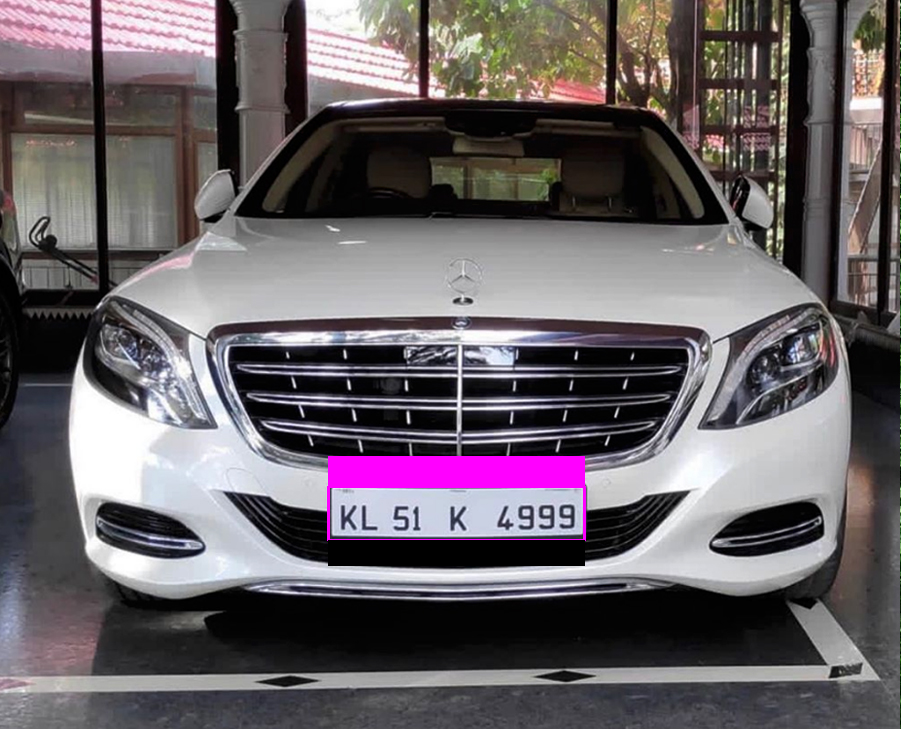

In [ ]:
results

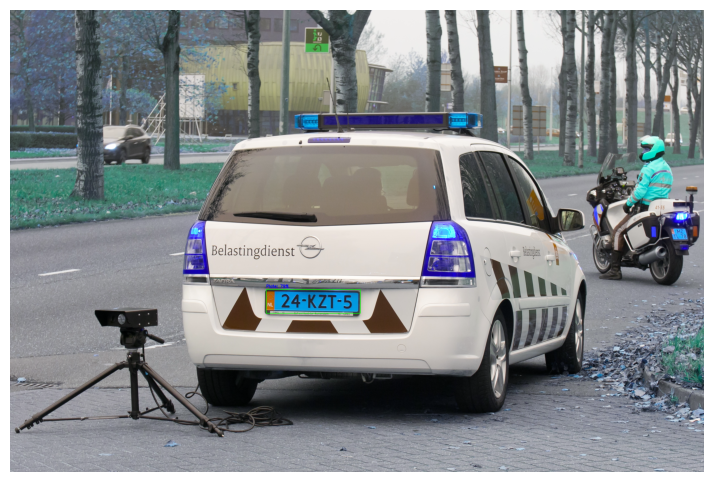

In [ ]:
import cv2
import matplotlib.pyplot as plt

def drawings(image, boxes_np, confidences_np, index):
    # Make a copy of the image to avoid modifying the original
    image_copy = image.copy()

    # Draw bounding boxes
    for ind in index:
        x, y, w, h = boxes_np[ind]
        bb_conf = confidences_np[ind]
        conf_text = f'Plate: {bb_conf*100:.0f}%'

        # Draw rectangle around plate
        cv2.rectangle(image_copy, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image_copy, conf_text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)

    return image_copy
import matplotlib.pyplot as plt

def yolo_predictions(img, net):
    # Step 1: Detections
    input_image, detections = get_detections(img, net)

    # Step 2: Apply Non-Maximum Suppression
    boxes_np, confidences_np, index = non_maximum_supression(input_image, detections)

    # Step 3: Draw Bounding Boxes
    result_img = drawings(img, boxes_np, confidences_np, index)

    # Step 4: Display the image
    plt.figure(figsize=(10, 6))  # Adjust size if needed
    plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct color display
    plt.axis("off")  # Hide axes
    plt.show()

    return result_img

img = io.imread('/content/number_plate_detection/images/N4.jpeg')
results = yolo_predictions(img, net)


# Making functions for testing and saving the license plate as output

In [ ]:
import cv2
import os

def drawings(image, boxes_np, confidences_np, index, save_path="/content/number_plate_detection/cropped_plates/"):
    # Create a directory to save cropped images if it doesn't exist
    os.makedirs(save_path, exist_ok=True)

    # Copy the image to avoid modifying the original
    image_copy = image.copy()

    plate_count = 1  # Naming index for multiple plates

    for ind in index:
        x, y, w, h = boxes_np[ind]
        bb_conf = confidences_np[ind]
        conf_text = f'Plate: {bb_conf*100:.0f}%'

        # Draw bounding box
        cv2.rectangle(image_copy, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image_copy, conf_text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)

        # Crop the detected license plate
        plate_crop = image[y:y+h, x:x+w]

        # Ensure cropped image is valid before saving
        if plate_crop.size > 0:
            filename = os.path.join(save_path, f"num_plate_{plate_count}.jpg")
            cv2.imwrite(filename, plate_crop)  # Save cropped plate image
            print(f"Saved: {filename}")
            plate_count += 1  # Increment for next plate

    return image_copy


In [ ]:
import matplotlib.pyplot as plt

def yolo_predictions(img, net):
    # Step 1: Get detections
    input_image, detections = get_detections(img, net)

    # Step 2: Apply Non-Maximum Suppression
    boxes_np, confidences_np, index = non_maximum_supression(input_image, detections)

    # Step 3: Draw bounding boxes & Extract plates
    result_img = drawings(img, boxes_np, confidences_np, index)

    # Step 4: Display image with bounding boxes
    plt.figure(figsize=(10, 6))
    plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct display
    plt.axis("off")
    plt.show()

    return result_img


In [ ]:
img = io.imread('/content/number_plate_detection/TEST/TEST.jpeg')
results = yolo_predictions(img, net)

# Saving license plates

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt
from skimage import io
import numpy as np

# Define paths
image_dir = "/content/number_plate_detection/images/"  # Path to your images
save_dir = "/content/number_plate_detection/cropped_plates/"  # Path to save cropped plates

# Create save directory if it doesn't exist
os.makedirs(save_dir, exist_ok=True)

# Function to process images in a loop
def process_images(image_dir, net):
    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]  # Get image list

    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        img = io.imread(image_path)  # Read image

        # Step 1: Get YOLO predictions
        input_image, detections = get_detections(img, net)

        # Step 2: Apply Non-Maximum Suppression
        boxes_np, confidences_np, index = non_maximum_supression(input_image, detections)

        # Step 3: Extract and save detected number plates
        plate_count = 1
        for ind in index:
            x, y, w, h = boxes_np[ind]
            plate_crop = img[y:y+h, x:x+w]  # Crop detected plate

            # Ensure cropped plate is valid
            if plate_crop.size > 0:
                plate_filename = f"num_plate_{image_file.split('.')[0]}_{plate_count}.jpg"
                plate_save_path = os.path.join(save_dir, plate_filename)
                cv2.imwrite(plate_save_path, plate_crop)
                print(f"Saved: {plate_save_path}")
                plate_count += 1  # Increment for multiple plates in the same image

        # Step 4: Draw bounding boxes for visualization
        result_img = drawings(img, boxes_np, confidences_np, index)

        # Step 5: Display the image with bounding boxes
        plt.figure(figsize=(10, 6))
        plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
        plt.axis("off")
        plt.show()

# Run processing loop on all images
process_images(image_dir, net)